It's not too hard to make a simple audio synthesizer in a Jupyter notebook.
IPywidgets has an [audio widget] for playing back sounds in the browser.

[audio widget]: https://ipywidgets.readthedocs.io/en/stable/examples/Beat%20Frequencies.html


In [1]:
from functools import lru_cache  # This import is just for speed
import ipywidgets
import IPython.display
from fractions import Fraction
import numpy as np
import os
import soundfile
import subprocess
import matplotlib.pyplot as plt

# Monkeypatching IPython.display.Audio:
# https://s.tk/questions/39077987/ipython-display-audio-cannot-correctly-handle-ogg-file-type
# Need to do this only for the sake of having small notebook files
import librosa
import librosa.display


import warnings
warnings.filterwarnings('ignore')

In order to keep my notebooks reasonably small for GitHub hosting, I'm converting my audio to .ogg format. 
I'm writing the raw audio to disk as a .wav file and converting to .ogg with [avconv].
I then load the .ogg file into an `Audio` widget.
I end up overwriting `output.ogg` as many times as I run the `make_audio_widget` function, but it doesn't matter because the data from the file actually gets copied into the notebook.
It's not the cleanest way to do this, but it's not really essential to the task anyway.

[avconv]: https://libav.org/avconv.html

In [2]:
def make_audio_widget(data, sample_rate, ogg=False):
    """Given some raw audio data, returns a player widget.
    The ogg==True branch is only for github's benefit because
    raw audio takes a lot of space.
    For personal use, ogg=False should be fine.
    """
    if ogg:

        if os.path.exists("output.ogg"):
            os.remove("output.ogg")
        soundfile.write("output.ogg", data, sample_rate, format="ogg", subtype="VORBIS")
        widget = IPython.display.Audio(filename="output.ogg")
        if os.path.exists("output.wav"):
            os.remove("output.wav")
        if os.path.exists("output.ogg"):
            os.remove("output.ogg")
        return widget
    else:
        return IPython.display.Audio(data, rate=sample_rate)

This helper function lets me synthesize $\sum_1^n\left(a_n sin\left(n \omega t \right)\right)$, given either a list of $a_n$s or a function $f(n) = a_n$.
With this function, I can synthesize a sound from its frequency spectrum.

In [3]:
def sin_series(basefrequency, timearray, coefficients, max_coefficients=20):
    """
    Inputs:
    -------
    basefrequency: Number. The base frequency (in Hertz) of the sound.
    timearray: Numpy array of shape(n,). The time at each sample.
    coefficients: Either a list of coefficients or a 
        function that maps coefficient indeces to coefficient values.
    """
    x = np.zeros_like(timearray)
    try:
        for coefficient in coefficients:
            x += coefficient * np.sin(
                2 * np.pi * timearray * basefrequency * coefficient
            )
    except TypeError:
        for coefficient in range(1, max_coefficients):
            # print(coefficients(coefficient))
            x += coefficients(coefficient) * np.sin(
                2 * np.pi * timearray * basefrequency * coefficient
            )
    x /= np.max(x)  # Normalize the waveform
    return x

# Exploring Tones

Let's try out our sin_series function and play a 440 A with some different coefficients.

In [4]:
SampleRate = 44100
BaseFreq = 440
Duration = 5
T = np.linspace(0, Duration, int(Duration * SampleRate))

First, let's try what happens if we just make every coefficient 1 (note that we only get the first 20 harmonics).

In [5]:
OnesSeries = 0.25 * sin_series(
    basefrequency=BaseFreq, timearray=T, coefficients=lambda x: 1, max_coefficients=50
)
make_audio_widget(OnesSeries, SampleRate)

That's a pretty terrible sound.
Let's make a simple function to plot the waveform.

In [6]:
def plot_waveform(Audio, Time, SampleRate, BaseFreq, NCycles=2):
    CQT = librosa.amplitude_to_db(np.abs(librosa.cqt(Audio, sr=SampleRate)), ref=np.max)
    figs, axes = plt.subplots(1, 2, figsize=(10, 4))
    plt.subplot(1, 2, 1)
    MaxIndex = int(NCycles / BaseFreq * SampleRate)
    plt.plot(Time[:MaxIndex], Audio[:MaxIndex])
    plt.subplot(1, 2, 2)
    librosa.display.specshow(CQT, y_axis="cqt_note")

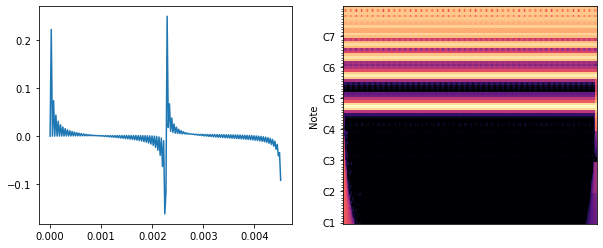

In [7]:
plot_waveform(OnesSeries, T, SampleRate, BaseFreq)

Maybe just a simple sine wave will work better.

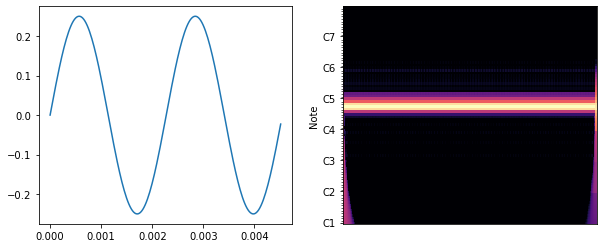

In [8]:
Fundamental = 0.25 * sin_series(basefrequency=BaseFreq, timearray=T, coefficients=[1])
display(make_audio_widget(Fundamental, SampleRate))
plot_waveform(Fundamental, T, SampleRate, BaseFreq)

It's pretty boring and the clicking at the start is annoying.
Let's do something about the click.
Let's try just ramping up the volume from zero.

In [9]:
def cancel_clicks(x, rampcount):
    anticlick = np.ones_like(x)
    ramp = np.linspace(0, 1, rampcount)
    anticlick[:rampcount] = ramp
    x *= anticlick
    return None

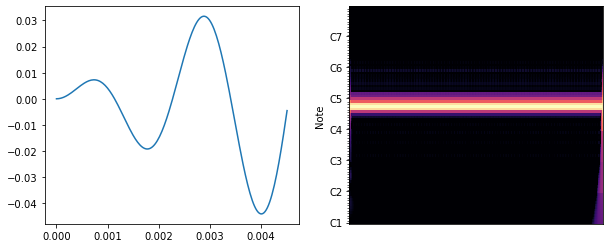

In [10]:
FundamentalNoClick = 0.25 * sin_series(
    basefrequency=BaseFreq, timearray=T, coefficients=[1]
)
cancel_clicks(FundamentalNoClick, 1000)
display(make_audio_widget(FundamentalNoClick, SampleRate))
plot_waveform(FundamentalNoClick, T, SampleRate, BaseFreq)

The click is gone. Now let's try coming up with a more interesting sound.
Here's $a_n = 1/n$.

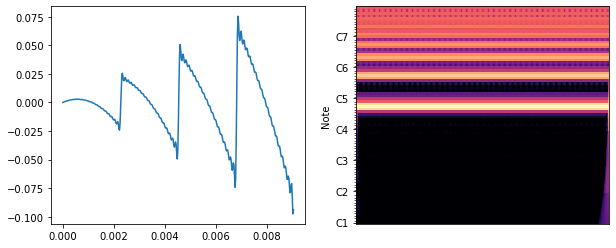

In [11]:
InverseSound = 0.25 * sin_series(
    basefrequency=BaseFreq, timearray=T, coefficients=lambda x: 1 / x
)
cancel_clicks(InverseSound, 1000)
display(make_audio_widget(InverseSound, SampleRate))
plot_waveform(InverseSound, T, SampleRate, BaseFreq, 4)

That's not great.
Looks like we made a triangle wave by accident.
Maybe if we knock the higher frequencies down more agressively it will sound better?
Here's $a_n = \frac{1}{n^2}$

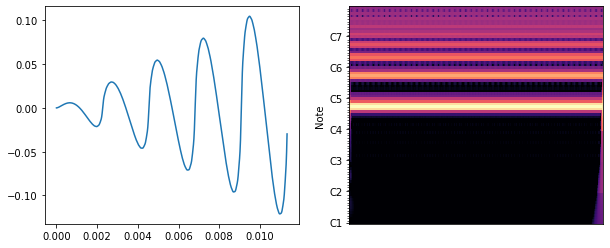

In [12]:
Inverse2Sound = 0.25 * sin_series(
    basefrequency=BaseFreq, timearray=T, coefficients=lambda x: 1 / x ** 2
)
cancel_clicks(Inverse2Sound, 1000)
display(make_audio_widget(Inverse2Sound, SampleRate))
plot_waveform(Inverse2Sound, T, SampleRate, BaseFreq, 5)

It's kind of interesting how it "feels" like the sound has sharp edges, but the waveform is pretty smooth.  
Let's try an exponential decay: here's $a_n = \frac{1}{e^n}$

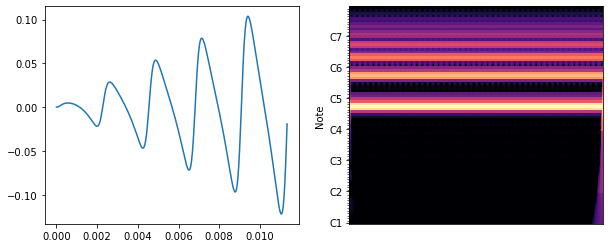

In [13]:
InverseExpSound = 0.25 * sin_series(
    basefrequency=BaseFreq, timearray=T, coefficients=lambda x: 1 / np.exp(x)
)
cancel_clicks(InverseExpSound, 1000)
display(make_audio_widget(InverseExpSound, SampleRate))
plot_waveform(InverseExpSound, T, SampleRate, BaseFreq, 5)

That actually sounds kind of nice!
Let's overlay the waveforms of $a_n = \frac{1}{n^2}$ and $a_n = \frac{1}{e^n}$:

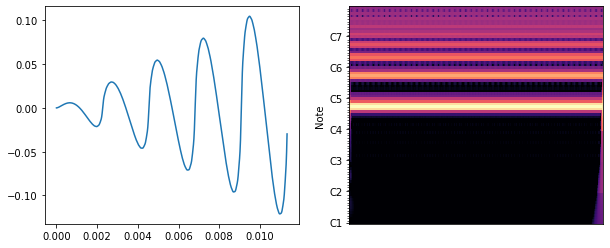

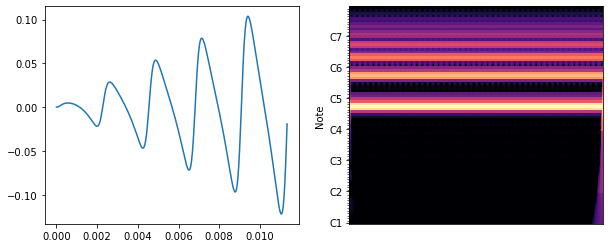

In [14]:
plot_waveform(Inverse2Sound, T, SampleRate, BaseFreq, 5)
plot_waveform(InverseExpSound, T, SampleRate, BaseFreq, 5)

It's surprising how subtle the difference is.

I think I like the inverse exponential function the best. 
Let's see what happens if we change the rate of decay.
Here's $a_n = \frac{1}{e^{2n}}$

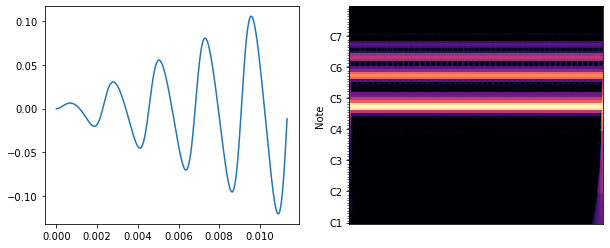

In [15]:
InverseExp2Sound = 0.25 * sin_series(
    basefrequency=BaseFreq, timearray=T, coefficients=lambda x: 1 / np.exp(2 * x)
)
cancel_clicks(InverseExp2Sound, 1000)
display(make_audio_widget(InverseExp2Sound, SampleRate))
plot_waveform(InverseExp2Sound, T, SampleRate, BaseFreq, 5)

It sounds a bit boring.
Let's try $a_n = {1}/{e^{\frac{1}{2}n}}$.

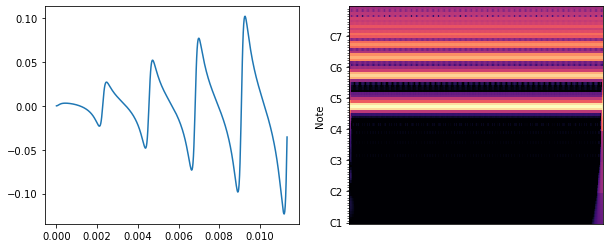

In [16]:
InverseExpHalfSound = 0.25 * sin_series(
    basefrequency=BaseFreq, timearray=T, coefficients=lambda x: 1 / np.exp(x / 2)
)
cancel_clicks(InverseExpHalfSound, 1000)
display(make_audio_widget(InverseExpHalfSound, SampleRate))
plot_waveform(InverseExpHalfSound, T, SampleRate, BaseFreq, 5)

So this is interesting. It looks similar the triangular waveform we got with $a_n = 1/n$, but it's smoother. The difference in the sound is profound.

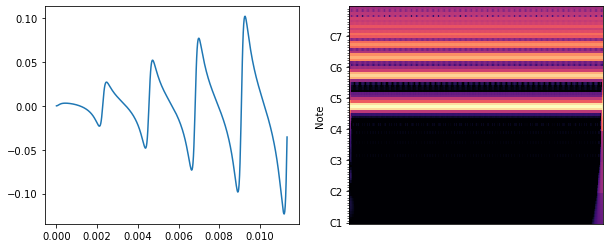

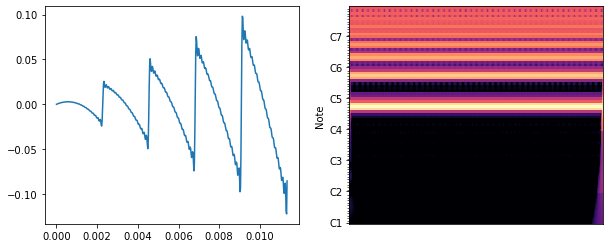

In [17]:
plot_waveform(InverseExpHalfSound, T, SampleRate, BaseFreq, 5)
plot_waveform(InverseSound, T, SampleRate, BaseFreq, 5)

It seems like we can get a range of decent-sounding tones using an inverse exponential function and varying the rate of the decay.
The `string_tone` function has a `tone` parameter that changes the rate of decay of the higher-order terms.  
The mathematical representation is 
$$\sum_{n=1}^N e^{-\tau *n} sin(\omega n t)$$
It's kind of like the tone knob on a guitar, but it's a bit more powerful.  
The `string_tone` function also decays the volume of the sound over time.  
I'm using the `@lru_cache` decorator in order to speed up processing later.

In [18]:
@lru_cache()
def string_tone(
    pitch, tone=1, volume=1, fade=1, sr=44010, final_loudness=0.001,
):
    duration = -fade * np.log(0.001)
    t = np.linspace(0, duration, int(duration * sr), endpoint=False)
    rampcount = int(sr * 0.005)
    x = sin_series(
        basefrequency=pitch, timearray=t, coefficients=lambda x: 1 / (np.exp(tone * x))
    )
    x = 0.25 * x / np.max(x)
    x *= np.exp(-t / fade)
    cancel_clicks(x, rampcount)
    x *= volume
    return x

Here's $\tau=\frac{3}{4}$

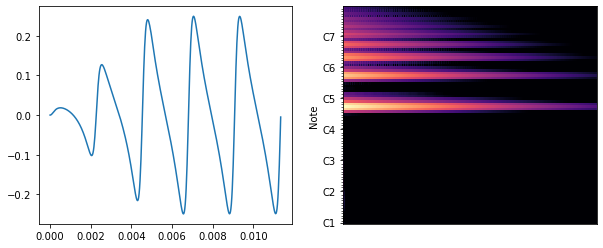

In [19]:
Tone3_4Sound = string_tone(pitch=BaseFreq, fade=2, tone=3 / 4)
display(make_audio_widget(Tone3_4Sound, SampleRate))
plot_waveform(Tone3_4Sound, T, SampleRate, BaseFreq, 5)

And here's $\tau={1/4}$

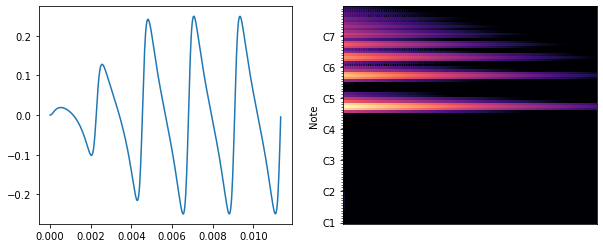

In [20]:
Tone1_4Sound = string_tone(pitch=BaseFreq, fade=2, tone=4 / 5)
display(make_audio_widget(Tone1_4Sound, SampleRate))
plot_waveform(Tone1_4Sound, T, SampleRate, BaseFreq, 5)

# Combining Tones

If we can combine tones, we can play chords and songs. This is where things start getting more fun.

Let's define a helper function that combines notes together. 
It takes a list of `(Tone, Time)` tuples where `Tone` is the array for the audio and `Time` is when it should play.

In [21]:
def make_track(
    Notes, SampleRate,
):
    Times = [time for sound, time in Notes]
    Track = np.zeros(int(max(Times) * SampleRate) + Notes[-1][0].shape[0])
    for Note, Time in Notes:
        StartIndex = int(SampleRate * Time)
        EndIndex = StartIndex + Note.shape[0]
        Track[StartIndex:EndIndex] += Note
    return Track

Let's try playing an A Major chord.
The frequency ratios of the notes in a major triad are (1, 5/4, 3/2).  
Note that the ratios are pretty simple (small numerator, small denominator) which is partially why major triads are easy on the ears.

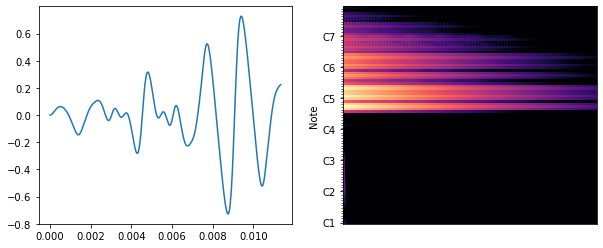

In [22]:
Ratios = [1, 5 / 4, 3 / 2]
Notes = []
for Ratio in Ratios:
    Tone = string_tone(pitch=BaseFreq * Ratio, fade=1, tone=1.5)
    Notes.append((Tone, 0))
MajorTriadSound = make_track(Notes, SampleRate)
display(make_audio_widget(MajorTriadSound, SampleRate))
plot_waveform(MajorTriadSound, T, SampleRate, BaseFreq, 5)

Here's an A Minor chord:

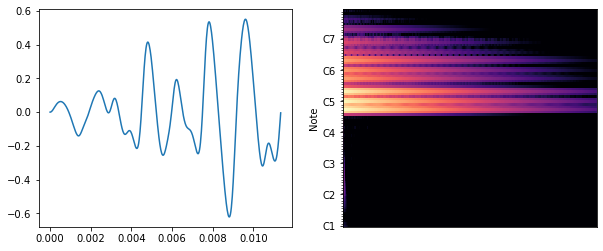

In [23]:
Ratios = [1, 6 / 5, 3 / 2]
Notes = []
for Ratio in Ratios:
    Tone = string_tone(pitch=BaseFreq * Ratio, fade=1, tone=1.5)
    Notes.append((Tone, 0))
MinorTriadSound = make_track(Notes, SampleRate)
display(make_audio_widget(MinorTriadSound, SampleRate))
plot_waveform(MinorTriadSound, T, SampleRate, BaseFreq, 5)

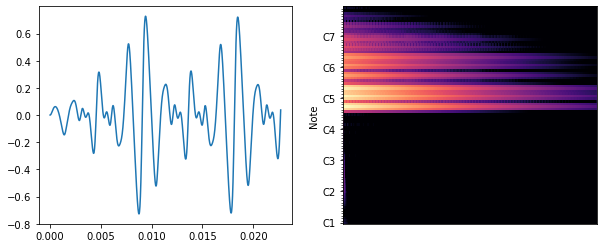

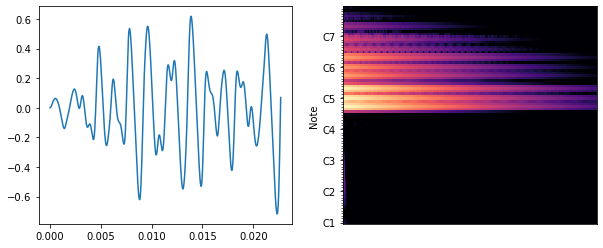

In [24]:
plot_waveform(MajorTriadSound, T, SampleRate, BaseFreq, 10)
plot_waveform(MinorTriadSound, T, SampleRate, BaseFreq, 10)

Here's an A Maj7:

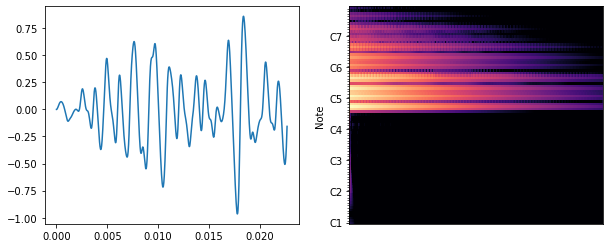

In [25]:
Ratios = [1, 5 / 4, 3 / 2, 17 / 9]
Notes = []
for Ratio in Ratios:
    Tone = string_tone(pitch=BaseFreq * Ratio, fade=1, tone=1.5)
    Notes.append((Tone, 0))
Major7TriadSound = make_track(Notes, SampleRate)
display(make_audio_widget(Major7TriadSound, SampleRate))
plot_waveform(Major7TriadSound, T, SampleRate, BaseFreq, 10)

Here's an A7:

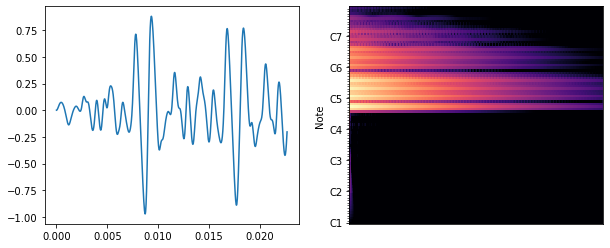

In [26]:
Ratios = [1, 5 / 4, 3 / 2, 16 / 9]
Notes = []
for Ratio in Ratios:
    Tone = string_tone(pitch=BaseFreq * Ratio, fade=1, tone=1.5)
    Notes.append((Tone, 0))
SevenTriadSound = make_track(Notes, SampleRate)
display(make_audio_widget(SevenTriadSound, SampleRate))
plot_waveform(SevenTriadSound, T, SampleRate, BaseFreq, 10)

Here's the dreaded Tritone:

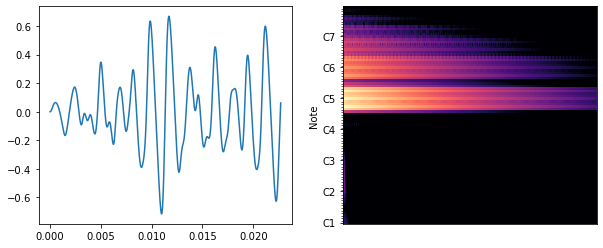

In [27]:
Ratios = [1, 2 ** 0.25, 2 ** 0.5]
Notes = []
for Ratio in Ratios:
    Tone = string_tone(pitch=BaseFreq * Ratio, fade=1, tone=1.5)
    Notes.append((Tone, 0))
TritoneSound = make_track(Notes, SampleRate)
display(make_audio_widget(TritoneSound, SampleRate))
plot_waveform(TritoneSound, T, SampleRate, BaseFreq, 10)

# Playing a Song

The next thing that would be interesting to do is try to play a song. To do this, I'm defining some functions that I can feed a list of text strings that encode musical notes. It can't handle chords but it works for simple things.

To start, I need a helper function that gives me the pitch of a note from its degree and octave.

In [28]:
def get_pitch(degree, octave, basefreq=32.70):
    degree = int(degree)
    octave = int(octave) - 1
    return 2 ** (degree / 12 + octave) * basefreq

A4 is the 10th degree of the 4th octave (degree is zero indexed), and it's about 440 Hz.

In [29]:
get_pitch(9, 4)

439.95700446074346

Close enough.

We'd like a helper function that interprets string representations of notes. I'm just representing notes as strings where the first character is the octave (in base 12) and the second character is the degree (also in base 12).

In [30]:
def get_pitch_from_string(s):
    octave = int(s[0], base=16)
    degree = int(s[1], base=16)
    return get_pitch(degree, octave)

To play something more interesting, we need a function to parse note durations as well.
We'll just let anything after the third character be interpreted as a float.

In [31]:
def get_duration_from_string(s):
    if len(s) > 2:
        duration = float(s[2:])
    else:
        duration = 1
    return duration

Now we can define a function that plays a song from a list of notes. It doesn't handle varying the duration of notes.

In [32]:
def play_simple_song(
    Notes, BaseDuration=0.25, NoteFade=1, SampleRate=44010, basefreq=32.70, **kwargs
):
    Progress = ipywidgets.Text(description="progress: ")
    length = len(Notes)
    IPython.display.display(Progress)
    NoteArrays = []
    Time = 0
    for i, NoteString in enumerate(Notes):
        Pitch = get_pitch_from_string(NoteString)
        Duration = get_duration_from_string(NoteString) * BaseDuration
        NoteArray = string_tone(Pitch, fade=NoteFade, sr=SampleRate, **kwargs)
        NoteArrays.append((NoteArray, Time))
        Time += Duration
        Progress.value = f"{i} / {length}"
    Track = make_track(NoteArrays, SampleRate)
    return make_audio_widget(Track, SampleRate)

Here's a simple A Maj7 arpeggio:

In [33]:
play_simple_song(
    "40 44 47 4b 50 4b 472 ".split() * 4,
    tone=0.5,
    volume=0.2,
    NoteFade=1,
    BaseDuration=0.25,
)

Text(value='', description='progress: ')

Let's try something a little more complicated. Here's the most soulless rendition possible of Bach's _Cello Suite No. 1 in G Major, Prelude_:

In [34]:
Prelude = (
    "20 27 34 32 34 27 34 27 " * 2
    + "20 29 35 34 35 29 35 29 " * 2
    + "20 2B 35 34 35 2B 35 2B " * 2
    + "20 30 34 32 34 30 34 30 "
    + "20 30 34 32 34 30 34 2B "
    + "20 29 34 32 34 30 2B 30 "
    + "29 30 2b 30 24 27 26 24 "
    + "26 30 32 30 32 30 32 30 " * 2
    + "2b 32 37 36 37 32 30 32 "
    + "2b 32 30 32 27 2b 29 27 "
    + "19 24 30 2B 30 24 30 24 " * 2
    + "19 26 27 29 27 26 24 22 "
    + "30 2b 29 37 36 34 32 30 "
    + "2b 29 27 37 32 37 2b 32 "
    + "27 29 2b 32 30 2b 29 27 "
    + "31 27 2a 29 2a 27 31 27 "
    + "34 27 2a 29 2a 27 31 27 "
    + "25 29 32 34 35 32 29 27 "
    + "25 29 32 34 35 32 2b 29 "
    + "28 2b 28 2b 32 2b 32 2b " * 2
    + "30 2b 29 30 2b 30 32 2b "
    + "30 2b 29 27 25 24 22 20 "
    + "1b 25 27 25 27 25 27 25 " * 2
    + "20 24 2a 29 2a 24 2a 24 " * 2
    + "20 25 29 27 29 25 29 25 " * 2
    + "20 2b 35 34 35 2b 35 2b " * 2
    + "20 30 34 32 34 30 2b 29 "
    + "27 25 24 22 20 1b 19 17 "
    + "16 22 29 2b 30 29 2b 30 " * 2
    + "15 22 27 29 2b 27 29 2b " * 2
    + "15 22 27 2b 32 36 378   "
    + "22 24 25 27 29 2b 30 32 "
    + "2b 27 29 2b 30 32 34 35 "
    + "32 2b 30 32 34 35 37 382 "
    + "   37 36 37 37 35 34 35 "
    + "35 32 2b 29 27 22 24 25 "
    + "17 1b 22 27 32 34 35 32 "
    + "34 30 27 25 24 20 22 24 "
    + "17 20 24 27 30 32 34 30 "
    + "36 33 32 33 33 32 31 32 "
    + "32 30 2b 30 30 29 26 24 "
    + "22 26 29 30 32 36 37 36 "
    + "37 32 2b 29 2b 32 27 2b "
    + "22 27 26 24 22 20 1b 19 "
    + "178                     "
    + "373      36 34 32 30 2b "
    + "29 37 36 34 32 30 2b 29 "
    + "27 36 34 32 30 2b 29 27 "
    + "25 34 32 30 2b 29 27 25 "
    + "24 32 30 2b 29 27 25 24 "
    + "22 30 2b 29 2b 32 27 32 "
    + "29 32 2b 32 30 32 29 32 "
    + "2b 32 27 32 30 32 29 32 " * 2
    + "2b 32 27 32 29 32 2b 32 "
    + "30 32 32 32 34 32 27 32 "
    + "32 32 34 32 35 32 27 32 "
    + "34 32 35 32 37 32 34 32 "
    + "35 32 34 32 35 32 32 32 "
    + "34 32 32 32 34 32 30 32 "
    + "32 32 30 32 32 32 2b 32 "
    + "30 32 2b 32 30 32 29 32 "
    + "2b 32 27 29 2a 27 2b 27 "
    + "30 27 31 27 32 27 33 27 "
    + "34 27 35 27 36 27 37 27 "
    + "38 27 39 27 3a 27 3b 27 "
    + "40 34 27 34 40 34 40 34 "
    + "40 34 27 34 40 34 40 34 "
    + "40 32 27 32 40 32 40 32 "
    + "40 32 27 32 40 32 40 32 "
    + "3b 35 27 35 3b 35 3b 35 "
    + "3b 35 27 35 3b 35 3b 35 "
    + "408"
).split()

In [35]:
play_simple_song(
    Prelude, BaseDuration=0.2, NoteFade=0.3, volume=0.2, tone=0.3,
)

Text(value='', description='progress: ')